In [1]:
# py38 environment, python = 3.8
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scanpy as sc

## v1.3 (final) clean data analysis

### Clustering

In [ ]:
adata = sc.read_h5ad('intermediate/half_dead_cells_removed.h5ad')

sc.pp.highly_variable_genes(adata, layer = 'raw_data', n_top_genes = 4000, flavor = 'seurat_v3')
adata.uns['id_hvg'] = np.where(adata.var['highly_variable'])[0]
sc.tl.pca(adata, n_comps=30, use_highly_variable=None)
sc.pp.neighbors(adata, n_neighbors=30, use_rep='X_pca', metric='euclidean', key_added='neighbors_30')
sc.tl.umap(adata, neighbors_key = 'neighbors_30', min_dist=0.1)
sc.tl.draw_graph(adata, layout='fa', random_state=0, neighbors_key='neighbors_30')

In [ ]:
import phenograph
cluster_label_1, graph, Q = phenograph.cluster(adata.obsm['X_pca'], clustering_algo = 'louvain', 
                                             k = 30, resolution_parameter = 1)

cluster_label_04, graph, Q = phenograph.cluster(adata.obsm['X_pca'], clustering_algo = 'louvain', 
                                             k = 30, resolution_parameter = 0.4)

cluster_label_06, graph, Q = phenograph.cluster(adata.obsm['X_pca'], clustering_algo = 'louvain', 
                                             k = 30, resolution_parameter = 0.6)

cluster_label_14, graph, Q = phenograph.cluster(adata.obsm['X_pca'], clustering_algo = 'louvain', 
                                             k = 30, resolution_parameter = 1.4)

# store the result in adata.obs
adata.obs['pheno_louvain_1.0'] = cluster_label_1.astype('str')
adata.obs['pheno_louvain_0.4'] = cluster_label_04.astype('str')
adata.obs['pheno_louvain_0.6'] = cluster_label_06.astype('str')
adata.obs['pheno_louvain_1.4'] = cluster_label_14.astype('str')

Finding 30 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 2.071049928665161 seconds
Jaccard graph constructed in 7.800450086593628 seconds
Wrote graph to binary file in 0.6458308696746826 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.814724
After 12 runs, maximum modularity is Q = 0.815838
Louvain completed 32 runs in 47.785574197769165 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 60.26323890686035 seconds
Finding 30 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 2.113067150115967 seconds
Jaccard graph constructed in 7.488683223724365 seconds
Wrote graph to binary file in 0.6373119354248047 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.810684
After 2 runs, maximum modularity is Q = 0.814238
After 4 runs, maximum modularity is Q = 0.816165
Louvain completed 24 runs in 33.51065111160278 seconds
So

In [ ]:
# store the result in adata.obs
adata.obs['pheno_louvain_1.0'] = cluster_label_1.astype('str')
adata.obs['pheno_louvain_0.4'] = cluster_label_04.astype('str')
adata.obs['pheno_louvain_0.6'] = cluster_label_06.astype('str')
adata.obs['pheno_louvain_1.4'] = cluster_label_14.astype('str')

#
adata.obs['pheno_louvain'] = cluster_label_1

adata.obs['pheno_louvain_1.0#'] = cluster_label_1
adata.obs['pheno_louvain_0.4#'] = cluster_label_04
adata.obs['pheno_louvain_0.6#'] = cluster_label_06
adata.obs['pheno_louvain_1.4#'] = cluster_label_14

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


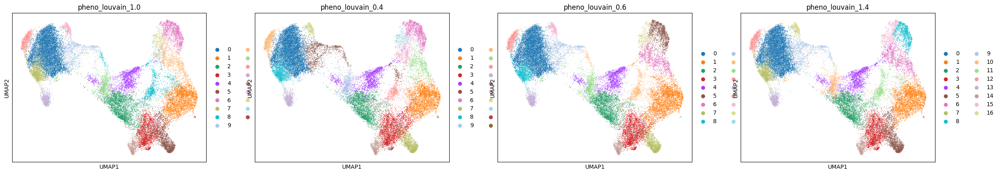

In [ ]:
sc.pl.umap(adata, color=['pheno_louvain_1.0', 'pheno_louvain_0.4', 'pheno_louvain_0.6', 'pheno_louvain_1.4'])

#### pheno_louvain_1.0

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


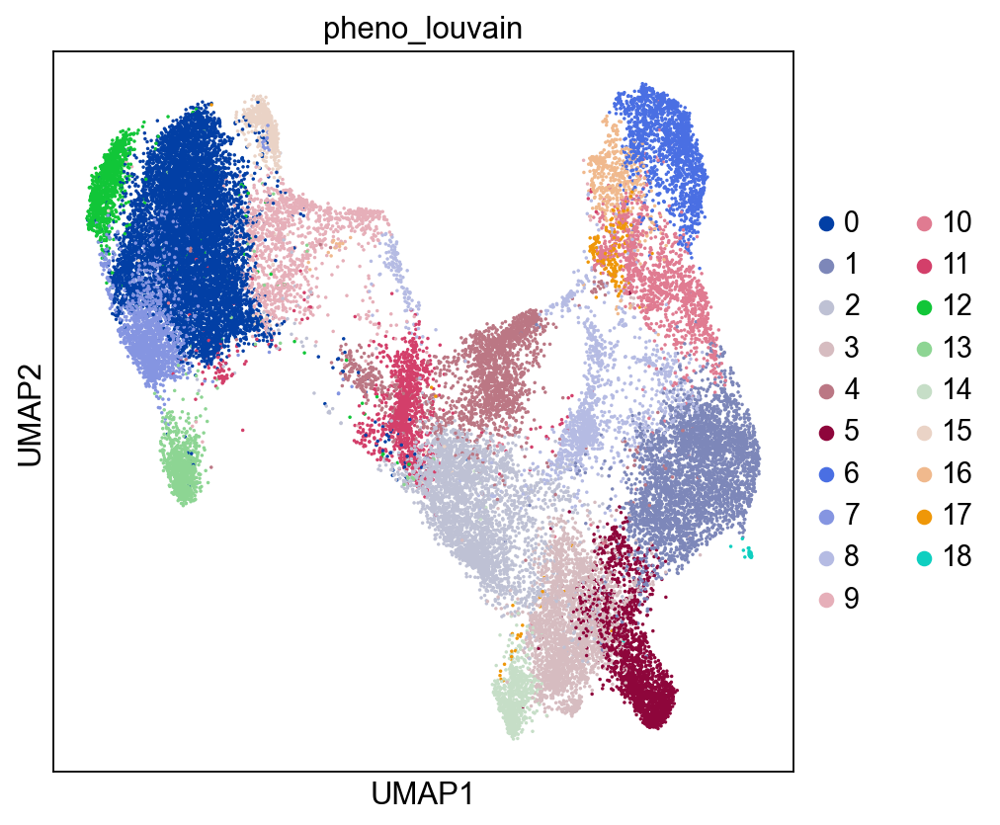

In [ ]:
sc.set_figure_params(scanpy=True, fontsize = 14, figsize = (6, 6))
sc.pl.umap(adata, color = ['pheno_louvain'], s = 10, palette = sc.pl.palettes.zeileis_28, ncols = 1)

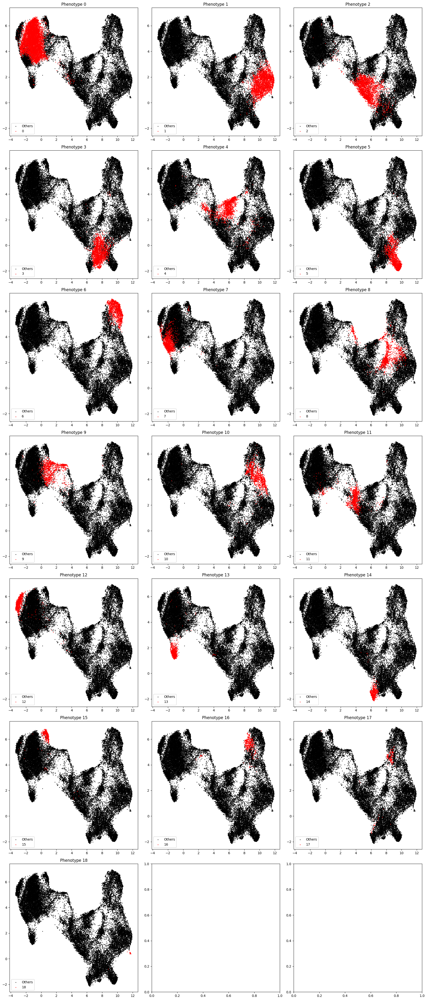

In [ ]:
nrows = 7
ncols = 3
fig, axs = plt.subplots(nrows, ncols, figsize = (6*ncols, 6*nrows))  # Adjust this according to your needs
axs = axs.ravel()  # flatten the axes for easy indexing

for i in range(len(adata.obs['pheno_louvain_1.0#'].unique())):  # for i from 0 to 20
    cells = np.isin(adata.obs['pheno_louvain'], [i])
    axs[i].scatter(adata.obsm['X_umap'][~cells, 0], adata.obsm['X_umap'][~cells, 1], s=1, c='k', label='Others')
    axs[i].scatter(adata.obsm['X_umap'][cells, 0], adata.obsm['X_umap'][cells, 1], s=1, c='r', label=f'{i}')
    axs[i].set_title(f'Phenotype {i}')
    axs[i].legend()
    axs[i].grid(False)

plt.tight_layout()
plt.show()

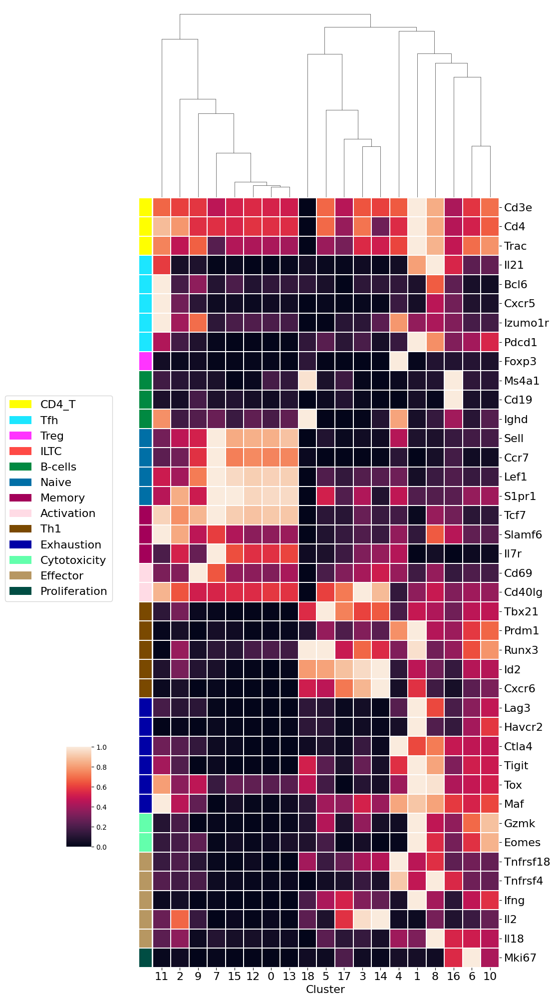

In [ ]:
markers_dict = {'CD4_T': ['Cd3e', 'Cd4', 'Trac'],
                'Tfh':['Il21', 'Bcl6', 'Cxcr5', 'Izumo1r', 'Pdcd1'],
                'Treg':['Foxp3'],
                'ILTC': ['Fcer1r'],
                'B-cells': ['Ms4a1', 'Cd19', 'Ighd'],
                'Naive': ['Sell', 'Ccr7', 'Lef1', 'S1pr1'],
                'Memory':['Tcf7', 'Slamf6', 'Il7r'],
                'Activation': ['Cd69', 'Cd40lg'],
                'Th1': ['Tbx21', 'Prdm1', 'Runx3', 'Id2', 'Cxcr6', 'Ly6c2' 'Ifngr'],
                'Exhaustion':['Lag3','Havcr2','Ctla4', 'Cd244', 'Tigit', 'Tox', 'Maf'],
                'Cytotoxicity': ['GzmB', 'Gzmk', 'Eomes'],
                'Effector':['Tnfrsf18', 'Tnfrsf4', 'Ifng', 'Il2', 'Il18'],
                'Proliferation': ['Mki67']
               }

ALLMARKERS = []
for key, value in markers_dict.items():
    markers_dict[key] = [j for j in value if j in adata.var_names]
    ALLMARKERS = ALLMARKERS + [j for j in markers_dict[key]]

# get some color palette
cols = sc.pl.palettes.godsnot_102
celltype_col = []
ct = 0
for key, value in markers_dict.items():
    celltype_col = celltype_col + [cols[ct]]*len(value)
    ct = ct + 1

sub_data = adata.X[:, [adata.var_names.get_loc(j) for j in ALLMARKERS]]
sub_data = pd.DataFrame(sub_data, columns = ALLMARKERS, index = adata.obs_names)
sub_data['Cluster'] = adata.obs['pheno_louvain']

sub_data_avg = sub_data.groupby('Cluster').mean()

g = sns.clustermap(sub_data_avg.T, standard_scale = 0,row_cluster = False, col_cluster = True,
                   figsize = (10, 20), linewidths = 0.005, cbar_pos=(0.05, .15, .05, .1), row_colors = celltype_col)
g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_ymajorticklabels(), fontsize = 16)
g.ax_heatmap.set_xticklabels(g.ax_heatmap.get_xmajorticklabels(), fontsize = 16)
g.ax_heatmap.set_xlabel('Cluster', fontsize = 16)

# Draw the legend bar for the classes                 
for ct, label in enumerate([j for j in markers_dict.keys()]):
    g.ax_col_dendrogram.bar(0, 0, color=cols[ct], label=label, linewidth=0)
g.ax_col_dendrogram.legend(ncol=1, bbox_to_anchor = (-0.1, -1), fontsize = 16, markerscale = 3)

# To save
#g.savefig('/path/to/save/heatmap_annot.png', dpi = 100, bbox_inches = 'tight')

#### pheno_louvain_0.4

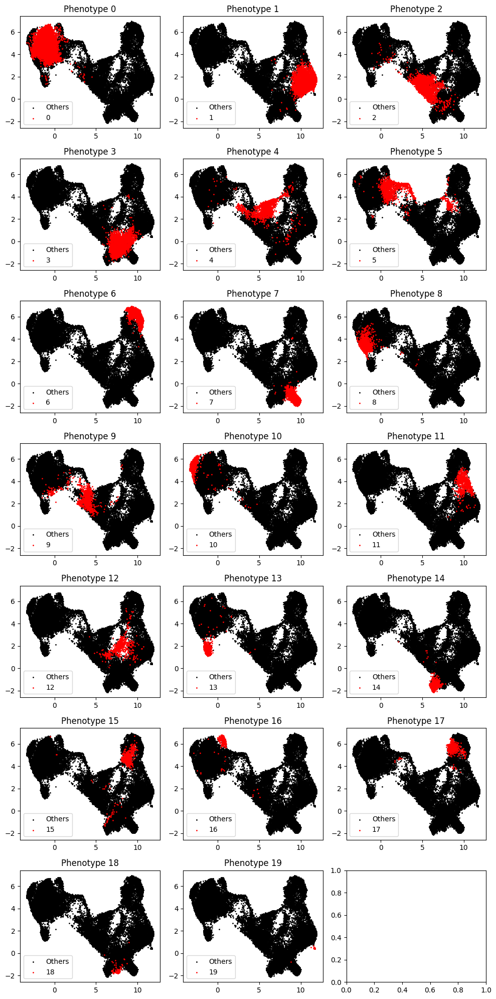

In [ ]:
fig, axs = plt.subplots(7, 3, figsize=(10,20))  # Adjust this according to your needs
axs = axs.ravel()  # flatten the axes for easy indexing

for i in range(len(adata.obs['pheno_louvain_0.4#'].unique())):  # for i from 0 to 20
    cells = np.isin(adata.obs['pheno_louvain_0.4#'], [i])
    axs[i].scatter(adata.obsm['X_umap'][~cells, 0], adata.obsm['X_umap'][~cells, 1], s=1, c='k', label='Others')
    axs[i].scatter(adata.obsm['X_umap'][cells, 0], adata.obsm['X_umap'][cells, 1], s=1, c='r', label=f'{i}')
    axs[i].set_title(f'Phenotype {i}')
    axs[i].legend()
    axs[i].grid(False)

plt.tight_layout()
plt.show()

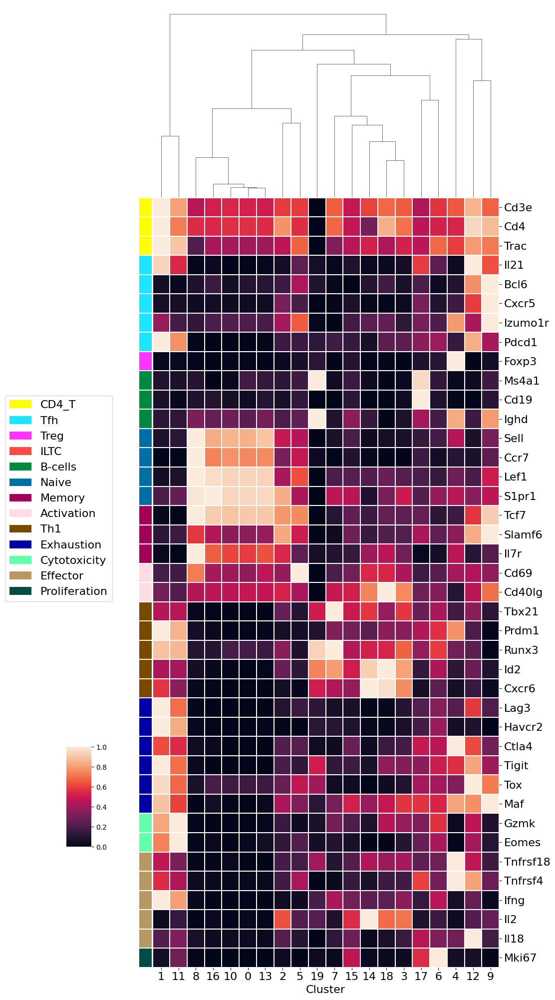

In [ ]:
sub_data = adata.X[:, [adata.var_names.get_loc(j) for j in ALLMARKERS]]
sub_data = pd.DataFrame(sub_data, columns = ALLMARKERS, index = adata.obs_names)
sub_data['Cluster'] = adata.obs['pheno_louvain_0.4']

sub_data_avg = sub_data.groupby('Cluster').mean()

g = sns.clustermap(sub_data_avg.T, standard_scale = 0,row_cluster = False, col_cluster = True,
                   figsize = (10, 20), linewidths = 0.005, cbar_pos=(0.05, .15, .05, .1), row_colors = celltype_col)
g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_ymajorticklabels(), fontsize = 16)
g.ax_heatmap.set_xticklabels(g.ax_heatmap.get_xmajorticklabels(), fontsize = 16)
g.ax_heatmap.set_xlabel('Cluster', fontsize = 16)

# Draw the legend bar for the classes                 
for ct, label in enumerate([j for j in markers_dict.keys()]):
    g.ax_col_dendrogram.bar(0, 0, color=cols[ct], label=label, linewidth=0)
g.ax_col_dendrogram.legend(ncol=1, bbox_to_anchor = (-0.1, -1), fontsize = 16, markerscale = 3)

#### pheno_louvain_1.4

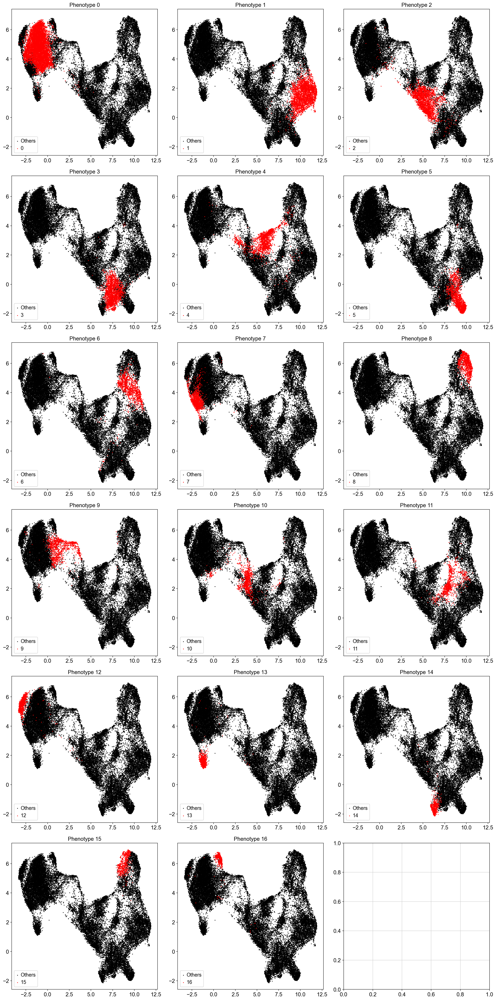

In [ ]:
nrows = 6
ncols = 3
fig, axs = plt.subplots(nrows, ncols, figsize = (6*ncols, 6*nrows))  # Adjust this according to your needs
axs = axs.ravel()  # flatten the axes for easy indexing

for i in range(len(adata.obs['pheno_louvain_1.4#'].unique())):  # for i from 0 to 20
    cells = np.isin(adata.obs['pheno_louvain_1.4#'], [i])
    axs[i].scatter(adata.obsm['X_umap'][~cells, 0], adata.obsm['X_umap'][~cells, 1], s=1, c='k', label='Others')
    axs[i].scatter(adata.obsm['X_umap'][cells, 0], adata.obsm['X_umap'][cells, 1], s=1, c='r', label=f'{i}')
    axs[i].set_title(f'Phenotype {i}')
    axs[i].legend()
    axs[i].grid(False)

plt.tight_layout()
plt.show()

#### save adata_clean2

In [ ]:
adata

AnnData object with n_obs × n_vars = 33466 × 16096
    obs: 'hash', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mito_frac', 'ribo_frac', 'doublet_score', 'predicted_doublet', 'predicted_doublet_as_string', 'pheno_louvain_0.4', 'pheno_louvain_0.6', 'pheno_louvain_1.0', 'annotation_v1', 'organ', 'sample', 'genotype', 'pheno_louvain_1.4', 'pheno_louvain_1.0#', 'pheno_louvain_0.4#', 'pheno_louvain_0.6#', 'pheno_louvain_1.4#'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'hvg', 'id_hvg', 'pca', 'neighbors_30', 'umap', 'draw_graph', 'neighbors', 'pheno_louvain_1.0_colors', 'pheno_louvain_0.4_colors', 'pheno_louvain_0.6_colors', 'pheno_louvain_1.4_

In [ ]:
# remove some old annotation 
columns_to_drop = ['pheno_louvain', 'pheno_louvain_str', 'pheno_louvain_0.8', 'annotation']
adata.obs = adata.obs.drop(columns=columns_to_drop)
#adata.obs['pheno_louvain'] = adata.obs['pheno_louvain_1.4'].astype('category')

In [ ]:
adata.obs['pheno_louvain'] = adata.obs['pheno_louvain_1.4'].astype('category')

In [ ]:
adata.write_h5ad('intermediate/half_dead_cells_removed_pheno_louvain.h5ad')

### Exploration

#### check expreesion of GOI

In [ ]:
# formating the color palette

# Define the keys
keys = ['WT', 'RII', 'PD1', '2KO', '3KO']
# Define the hex colors
hex_colors = ['#CACACA', '#7CAE00', '#1F78B4', '#F8766D', '#C77CFF']

# Create the color palette dictionary
palette_dict_geno = dict(zip(keys, hex_colors))


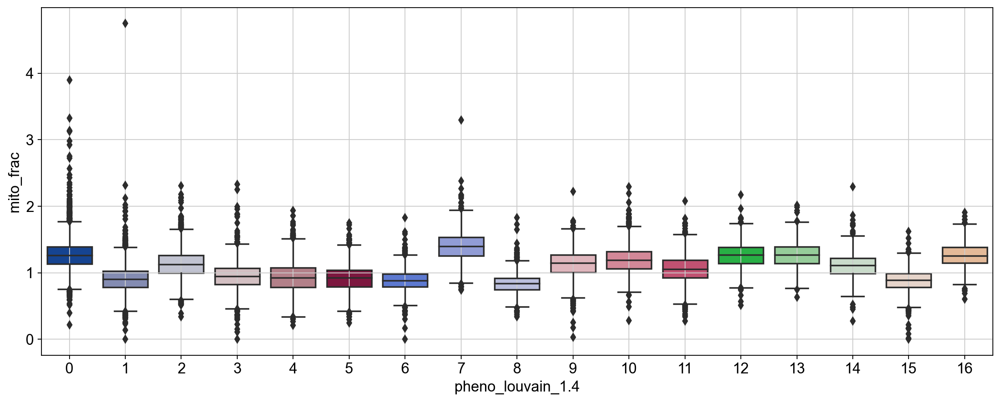

In [ ]:
sc.set_figure_params(scanpy=True, fontsize = 14)
df_temp = adata.obs[['mito_frac', 'pheno_louvain_1.4']]

import seaborn as sns
fig = plt.figure(figsize = (8*2, 6))
ax = fig.add_subplot(1, 1, 1)
sns.boxplot(x = "pheno_louvain_1.4", y = "mito_frac", data = df_temp, ax = ax, 
            palette = sc.pl.palettes.zeileis_28)
ax.grid('on')

# seems so good now

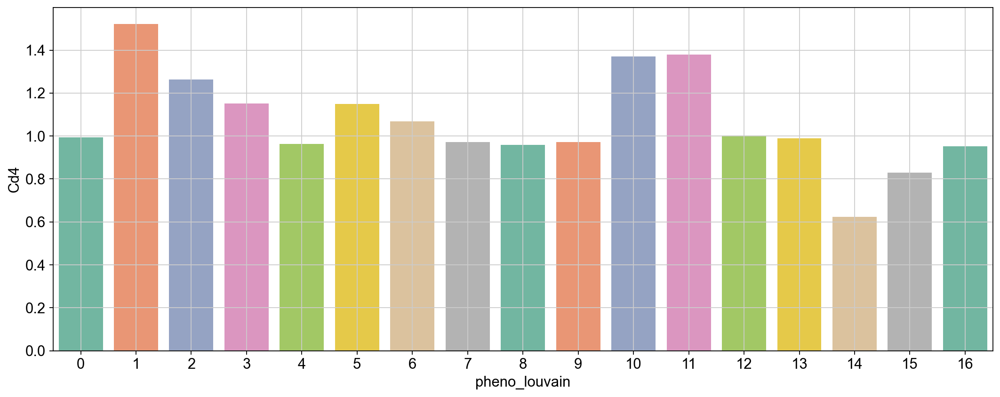

In [ ]:
# check whether they express CD4
sc.set_figure_params(scanpy=True, fontsize = 14)
df_temp = pd.DataFrame({'pheno_louvain': adata.obs['pheno_louvain'], 
                        'sample': adata.obs['sample'], 
                        'Cd4': adata.X[:, adata.var_names.get_loc('Cd4')]}, index = adata.obs.index)

import seaborn as sns
fig = plt.figure(figsize = (8*2, 6))
ax = fig.add_subplot(1, 1, 1)
sns.barplot(x = "pheno_louvain", y = "Cd4",  data = df_temp, ax = ax, 
            palette = 'Set2',  errorbar = None)
ax.grid('on')

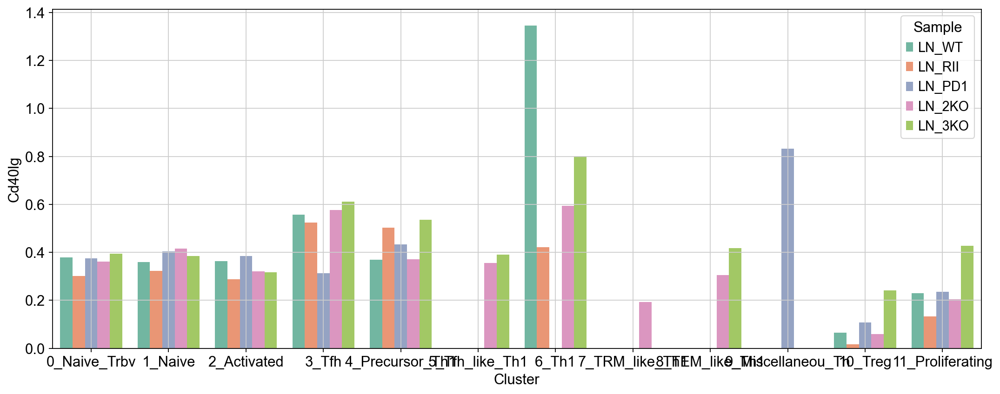

In [ ]:
# check whether they express CD40 ligand 
sc.set_figure_params(scanpy=True, fontsize = 14)
df_temp = pd.DataFrame({'Cluster': adata.obs['annotation'], 
                        'Sample': adata.obs['sample'], 
                        'Cd40lg': adata.X[:, adata.var_names.get_loc('Cd40lg')]}, index = adata.obs.index)
hue_order = ['LN_WT', 'LN_RII', 'LN_PD1', 'LN_2KO', 'LN_3KO']

fig = plt.figure(figsize = (8*2, 6))
ax = fig.add_subplot(1, 1, 1)
sns.barplot(x = "Cluster", y = "Cd40lg",  hue='Sample', data = df_temp, ax = ax, 
            palette = 'Set2', hue_order=hue_order, errorbar = None)
ax.grid('on')

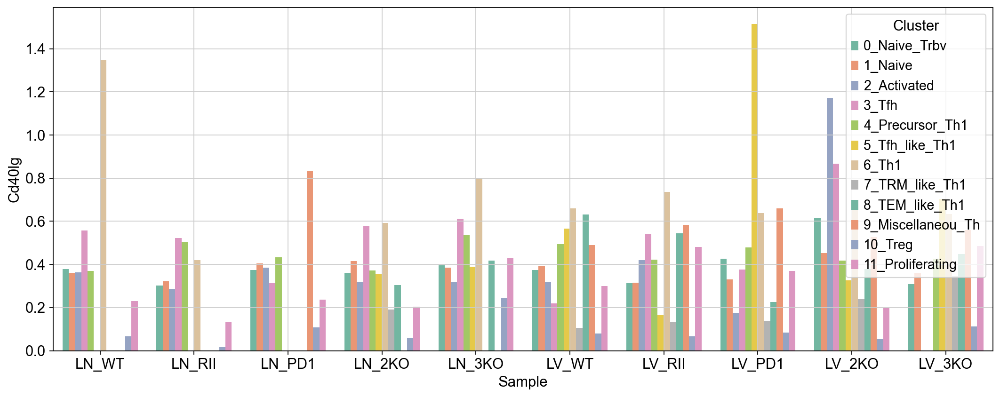

In [ ]:
# check whether they express CD40 ligand 
sc.set_figure_params(scanpy=True, fontsize = 14)
df_temp = pd.DataFrame({'Cluster': adata.obs['annotation'], 
                        'Sample': adata.obs['sample'], 
                        'Cd40lg': adata.X[:, adata.var_names.get_loc('Cd40lg')]}, index = adata.obs.index)
sample_order = ['LN_WT', 'LN_RII', 'LN_PD1', 'LN_2KO', 'LN_3KO', 'LV_WT', 'LV_RII', 'LV_PD1', 'LV_2KO', 'LV_3KO']

fig = plt.figure(figsize = (8*2, 6))
ax = fig.add_subplot(1, 1, 1)
sns.barplot(x = "Sample", y = "Cd40lg",  hue='Cluster', data = df_temp, ax = ax, 
            palette = 'Set2', order = sample_order, errorbar = None)
ax.grid('on')

In [ ]:
print(adata.obs['annotation'].unique())

['01_Naive', '02_Activated', '00_Naive_Trbv', '04_Precursor_Th1', '11_Proliferating', ..., '08_TEM_like_Th1', '09_Miscellaneous_Th', '06_Th1', '07_TRM_like_Th1', '05_Tfh_like_Th1']
Length: 12
Categories (12, object): ['00_Naive_Trbv', '01_Naive', '02_Activated', '03_Tfh', ..., '08_TEM_like_Th1', '09_Miscellaneous_Th', '10_Treg', '11_Proliferating']


In [ ]:
cluster_list = []

/Users/gaos1/anaconda3/envs/py39/lib/python3.9/site-packages/pandas/core/arrays/categorical.py:537: RuntimeWarning: invalid value encountered in cast
  np.array(self.categories._na_value).astype(dtype)


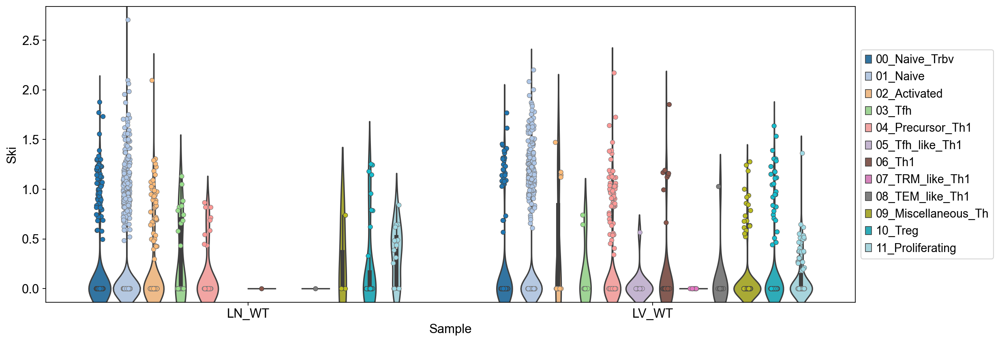

In [ ]:
# check TGFb downstream gene
sc.set_figure_params(scanpy=True, fontsize = 14)
df_temp = pd.DataFrame({'Cluster': adata.obs['annotation'], 
                        'Sample': adata.obs['sample'], 
                        'Ski': adata.X[:, adata.var_names.get_loc('Ski')]}, index = adata.obs.index)
sample_order = ['LN_WT', 'LV_WT']

fig = plt.figure(figsize = (8*2, 6))
ax = fig.add_subplot(1, 1, 1)
sns.violinplot(x = "Sample", y = "Ski",  hue='Cluster', data = df_temp, ax = ax, 
            palette = palette_dict, order = sample_order)
ax.get_legend().remove()
# Adding swarmplot on top of the boxplot
sns.stripplot(x="Sample", y="Ski", hue='Cluster', data=df_temp, ax=ax, 
              palette=palette_dict, order=sample_order, dodge=True, size=5, edgecolor="gray", linewidth=0.5, legend = False)
ax.grid(False)
# Adjust the position of the legend
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
fig.savefig('grant_figure/6b_1_Ski_v2.pdf', format='pdf', dpi=300)

/Users/gaos1/anaconda3/envs/py39/lib/python3.9/site-packages/pandas/core/arrays/categorical.py:537: RuntimeWarning: invalid value encountered in cast
  np.array(self.categories._na_value).astype(dtype)


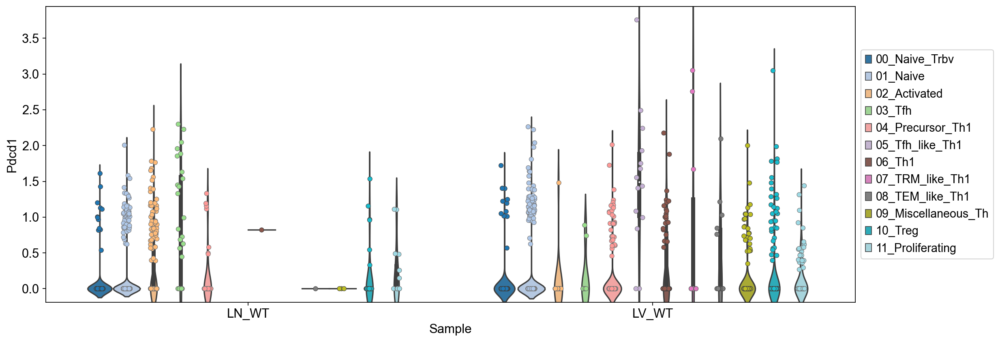

In [ ]:
# check PD1
sc.set_figure_params(scanpy=True, fontsize = 14)
df_temp = pd.DataFrame({'Cluster': adata.obs['annotation'], 
                        'Sample': adata.obs['sample'], 
                        'Pdcd1': adata.X[:, adata.var_names.get_loc('Pdcd1')]}, index = adata.obs.index)
sample_order = ['LN_WT', 'LV_WT']

fig = plt.figure(figsize = (8*2, 6))
ax = fig.add_subplot(1, 1, 1)
sns.violinplot(x = "Sample", y = "Pdcd1",  hue='Cluster', data = df_temp, ax = ax, 
            palette = palette_dict, order = sample_order)
ax.get_legend().remove()
# Adding swarmplot on top of the boxplot
sns.stripplot(x="Sample", y="Pdcd1", hue='Cluster', data=df_temp, ax=ax, 
              palette=palette_dict, order=sample_order, dodge=True, size=5, edgecolor="gray", linewidth=0.5, legend = False)
ax.grid(False)
# Adjust the position of the legend
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
fig.savefig('grant_figure/6b_2_Pdcd1_v2.pdf', format='pdf', dpi=300)

/Users/gaos1/anaconda3/envs/py39/lib/python3.9/site-packages/pandas/core/arrays/categorical.py:537: RuntimeWarning: invalid value encountered in cast
  np.array(self.categories._na_value).astype(dtype)


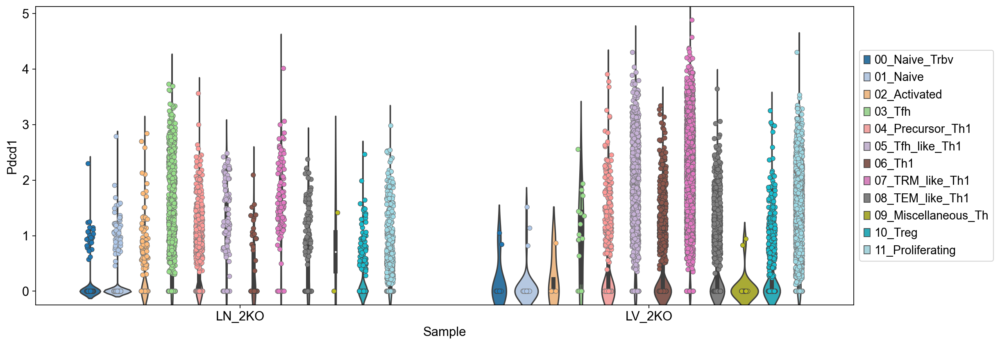

In [ ]:
# PD1 gene transcript is still detected and highly upregulated in 2KO 
sc.set_figure_params(scanpy=True, fontsize = 14)
df_temp = pd.DataFrame({'Cluster': adata.obs['annotation'], 
                        'Sample': adata.obs['sample'], 
                        'Pdcd1': adata.X[:, adata.var_names.get_loc('Pdcd1')]}, index = adata.obs.index)
sample_order = ['LN_2KO', 'LV_2KO']

fig = plt.figure(figsize = (8*2, 6))
ax = fig.add_subplot(1, 1, 1)
sns.violinplot(x = "Sample", y = "Pdcd1",  hue='Cluster', data = df_temp, ax = ax, 
            palette = palette_dict, order = sample_order)
ax.get_legend().remove()
# Adding swarmplot on top of the boxplot
sns.stripplot(x="Sample", y="Pdcd1", hue='Cluster', data=df_temp, ax=ax, 
              palette=palette_dict, order=sample_order, dodge=True, size=5, edgecolor="gray", linewidth=0.5, legend = False)
ax.grid(False)
# Adjust the position of the legend
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
fig.savefig('grant_figure/6b_2_Pdcd1_v2.pdf', format='pdf', dpi=300)

/Users/gaos1/anaconda3/envs/py39/lib/python3.9/site-packages/pandas/core/arrays/categorical.py:537: RuntimeWarning: invalid value encountered in cast
  np.array(self.categories._na_value).astype(dtype)


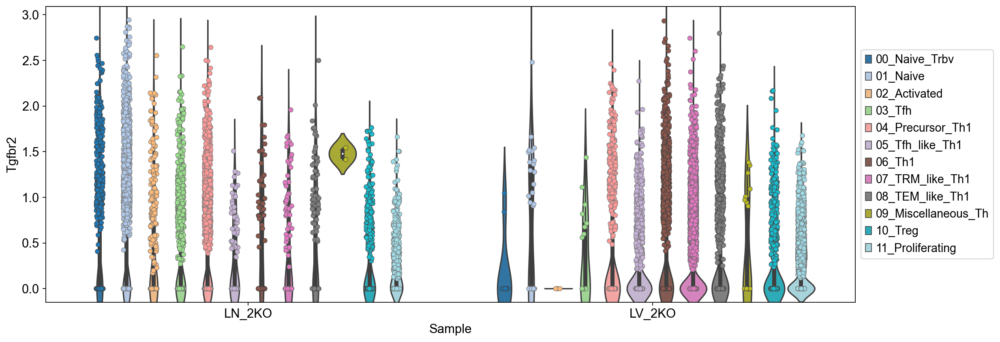

In [ ]:
# Tgfbr2
sc.set_figure_params(scanpy=True, fontsize = 14)
df_temp = pd.DataFrame({'Cluster': adata.obs['annotation'], 
                        'Sample': adata.obs['sample'], 
                        'Tgfbr2': adata.X[:, adata.var_names.get_loc('Tgfbr2')]}, index = adata.obs.index)
sample_order = ['LN_2KO', 'LV_2KO']

fig = plt.figure(figsize = (8*2, 6))
ax = fig.add_subplot(1, 1, 1)
sns.violinplot(x = "Sample", y = "Tgfbr2",  hue='Cluster', data = df_temp, ax = ax, 
            palette = palette_dict, order = sample_order)
ax.get_legend().remove()
# Adding swarmplot on top of the boxplot
sns.stripplot(x="Sample", y="Tgfbr2", hue='Cluster', data=df_temp, ax=ax, 
              palette=palette_dict, order=sample_order, dodge=True, size=5, edgecolor="gray", linewidth=0.5, legend = False)
ax.grid(False)
# Adjust the position of the legend
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
#fig.savefig('grant_figure/6b_2_Pdcd1_v2.pdf', format='pdf', dpi=300)

/Users/gaos1/anaconda3/envs/py39/lib/python3.9/site-packages/pandas/core/arrays/categorical.py:537: RuntimeWarning: invalid value encountered in cast
  np.array(self.categories._na_value).astype(dtype)


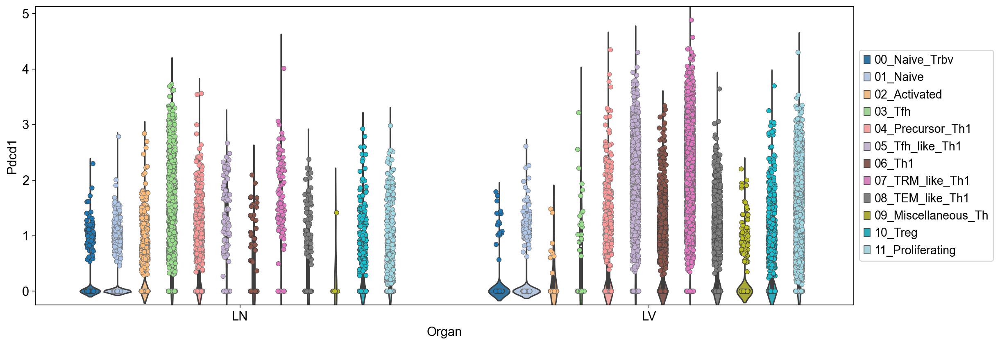

In [ ]:
# check whether they express CD4
sc.set_figure_params(scanpy=True, fontsize = 14)
df_temp = pd.DataFrame({'Cluster': adata.obs['annotation'], 
                        'Organ': adata.obs['organ'], 
                        'Pdcd1': adata.X[:, adata.var_names.get_loc('Pdcd1')]}, index = adata.obs.index)
#sample_order = ['LN_2KO', 'LV_2KO']

fig = plt.figure(figsize = (8*2, 6))
ax = fig.add_subplot(1, 1, 1)
sns.violinplot(x = "Organ", y = "Pdcd1",  hue='Cluster', data = df_temp, ax = ax, 
            palette = palette_dict)
ax.get_legend().remove()
# Adding swarmplot on top of the boxplot
sns.stripplot(x="Organ", y="Pdcd1", hue='Cluster', data=df_temp, ax=ax, 
              palette=palette_dict, dodge=True, size=5, edgecolor="gray", linewidth=0.5, legend = False)
ax.grid(False)
# Adjust the position of the legend
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
#fig.savefig('grant_figure/6b_2_Pdcd1_v2.pdf', format='pdf', dpi=300)

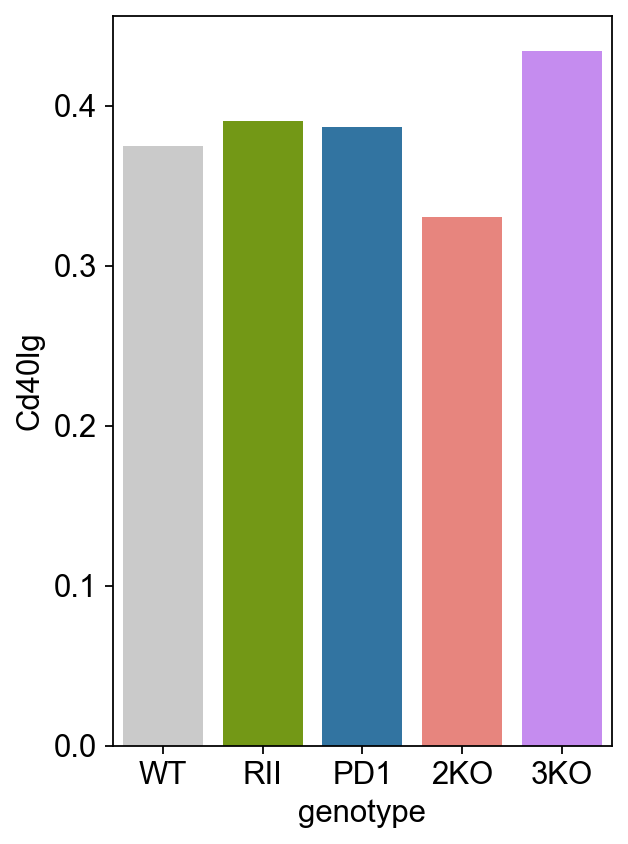

In [ ]:
# check whether they express Cd40lg
sc.set_figure_params(scanpy=True, fontsize = 14)
df_temp = pd.DataFrame({'pheno_louvain': adata.obs['pheno_louvain'], 
                        'genotype': adata.obs['genotype'], 
                        'Cd40lg': adata.X[:, adata.var_names.get_loc('Cd40lg')]}, index = adata.obs.index)
sample_order = ['WT', 'RII', 'PD1', '2KO', '3KO']
fig = plt.figure(figsize = (4, 6))
ax = fig.add_subplot(1, 1, 1)
sns.barplot(x = "genotype", y = "Cd40lg",  data = df_temp, ax = ax, 
            palette = palette_dict_geno,  errorbar = None, order = sample_order)
ax.grid(False)

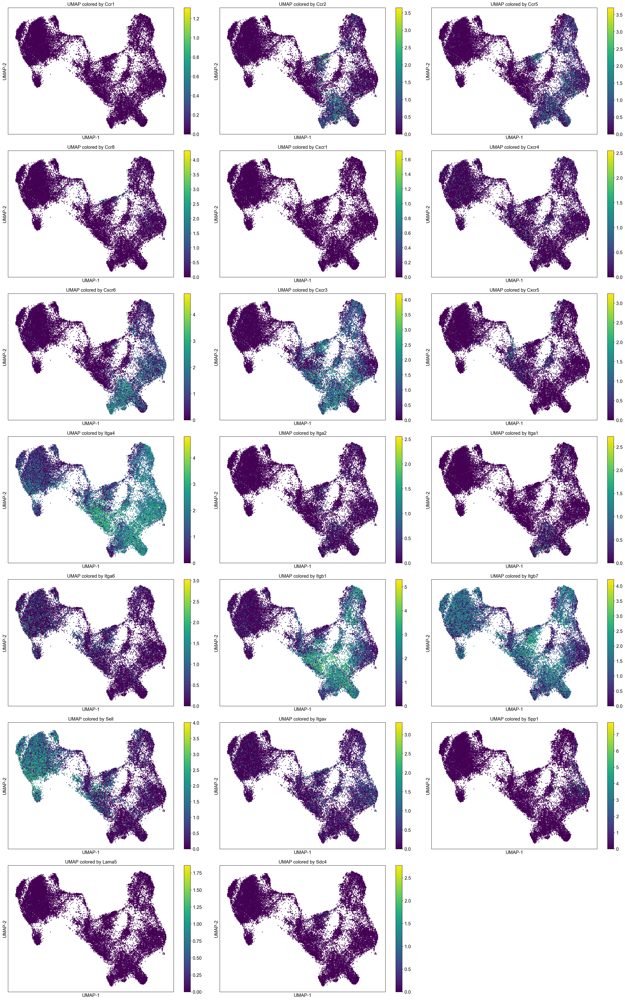

In [ ]:
genes = ['Ccr1', 'Ccr2', 'Ccr5', 'Ccr8','Cxcr1','Cxcr4', 'Cxcr6', 'Cxcr3','Cxcr5', 'Itga4', 'Itga2', 'Itga1', 'Itga6', 'Itgb1', 'Itgb7', 'Sell', 'Itgav', 'Spp1', 'Lama5', 'Sdc4']


fig_nrow = 7
fig_ncol = 3

fig = plt.figure(figsize = (9*fig_ncol, 6*fig_nrow))
count = 0
for gene_name in genes:
    ax = fig.add_subplot(fig_nrow, fig_ncol, count + 1)
    col_gene = adata.X[:, adata.var_names.get_loc(gene_name)]
    im1 = ax.scatter(adata.obsm['X_umap'][:, 0], adata.obsm['X_umap'][:, 1], s = 2, c = col_gene, 
                    cmap = 'viridis')
    ax.set_xlabel('UMAP-1', fontsize = 14)
    ax.set_ylabel('UMAP-2', fontsize = 14)
    ax.set_title('UMAP colored by ' + gene_name, fontsize = 14)
    ax.set_xticks([])
    ax.set_yticks([])
    fig.colorbar(im1)
    count = count + 1
plt.tight_layout()
#fig.savefig('grant_figure/UMAP by gene.pdf', format='pdf', dpi=60)

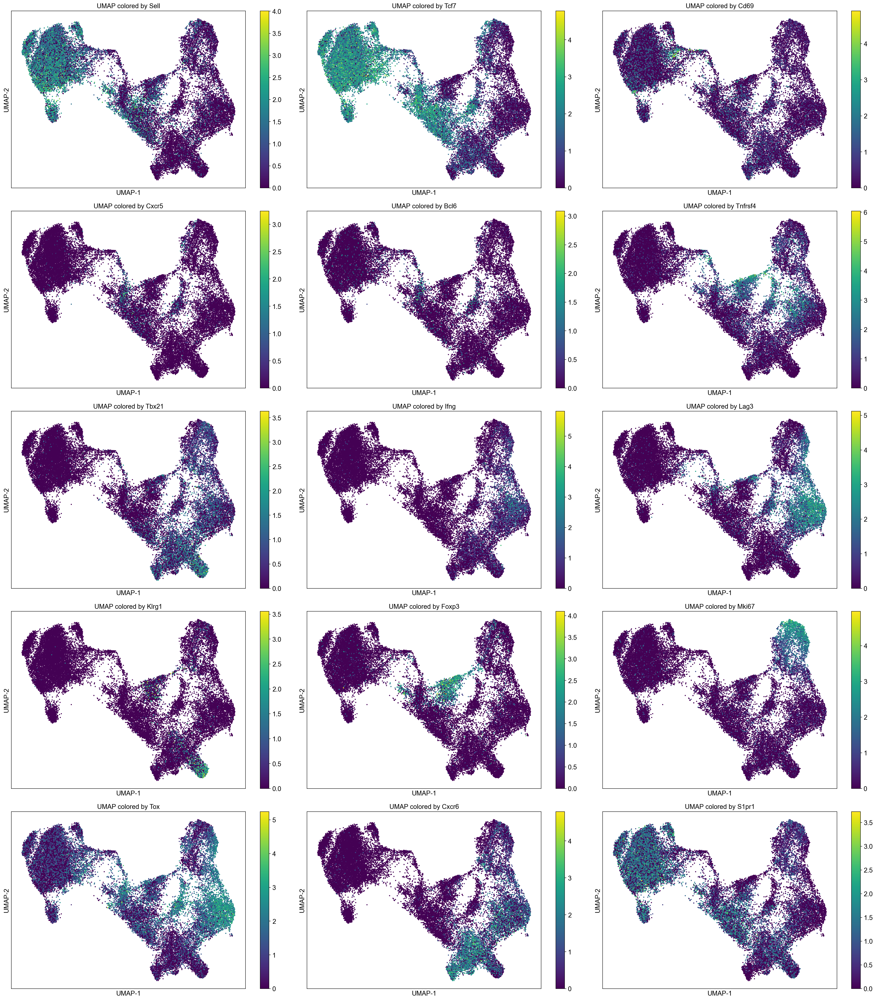

In [ ]:
genes = ['Sell', 'Tcf7', 'Cd69', 'Cxcr5','Bcl6','Tnfrsf4', 'Tbx21', 'Ifng','Lag3', 'Klrg1', 'Foxp3', 'Mki67', 'Tox', 'Cxcr6', 'S1pr1']


fig_nrow = 5
fig_ncol = 3

fig = plt.figure(figsize = (9*fig_ncol, 6*fig_nrow))
count = 0
for gene_name in genes:
    ax = fig.add_subplot(fig_nrow, fig_ncol, count + 1)
    col_gene = adata.X[:, adata.var_names.get_loc(gene_name)]
    im1 = ax.scatter(adata.obsm['X_umap'][:, 0], adata.obsm['X_umap'][:, 1], s = 2, c = col_gene, 
                    cmap = 'viridis')
    ax.set_xlabel('UMAP-1', fontsize = 14)
    ax.set_ylabel('UMAP-2', fontsize = 14)
    ax.set_title('UMAP colored by ' + gene_name, fontsize = 14)
    ax.set_xticks([])
    ax.set_yticks([])
    fig.colorbar(im1)
    count = count + 1
plt.tight_layout()

In [ ]:
cluster_genes = ['Tgfbr2','Tcf7', 'Sell', 'Lef1', 'Cd69', 'Ccr7', 'Il7r', 'Ly6c2','Foxp3', 'Il2ra', 'Il21', 'Bcl6', 'Prdm1','Pdcd1', 'Lag3', 'Cxcr6', 'Gzmk',
                 'Ifng', 'Ifngr1','Tbx21', 'Il2', 'Ldha', 'Mki67', 'Itgae','Cd40lg' ]

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


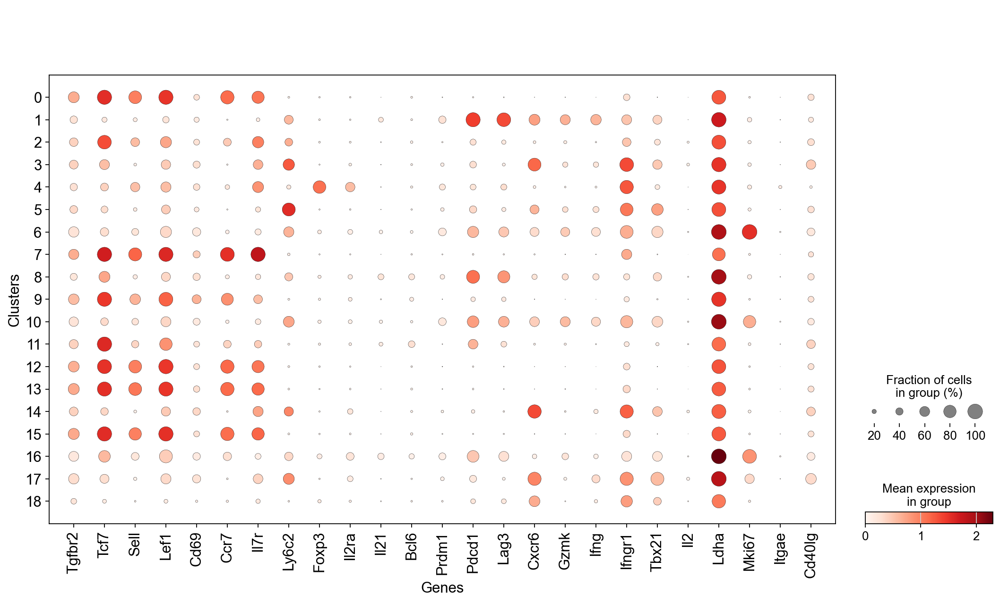

In [ ]:
fig = plt.figure(figsize = (8*2, 6*1.5))
ax1 = fig.add_subplot(1, 1, 1)
ac = sc.pl.dotplot(adata, cluster_genes, groupby = 'pheno_louvain', log=True, layer = 'norm_counts', 
                   show = False, ax = ax1)

# Label the x and y-axes
ac['mainplot_ax'].set_xlabel('Genes', fontsize = 14)
ac['mainplot_ax'].set_ylabel('Clusters', fontsize = 14)

# Increase the fontsize of the x ticklabels
ac['mainplot_ax'].set_xticklabels(ac['mainplot_ax'].get_xticklabels(), fontsize = 14)

# Increase the fontsize of the y ticklabels
ac['mainplot_ax'].set_yticklabels(ac['mainplot_ax'].get_yticklabels(), fontsize = 14);

#### proportion of each cluster

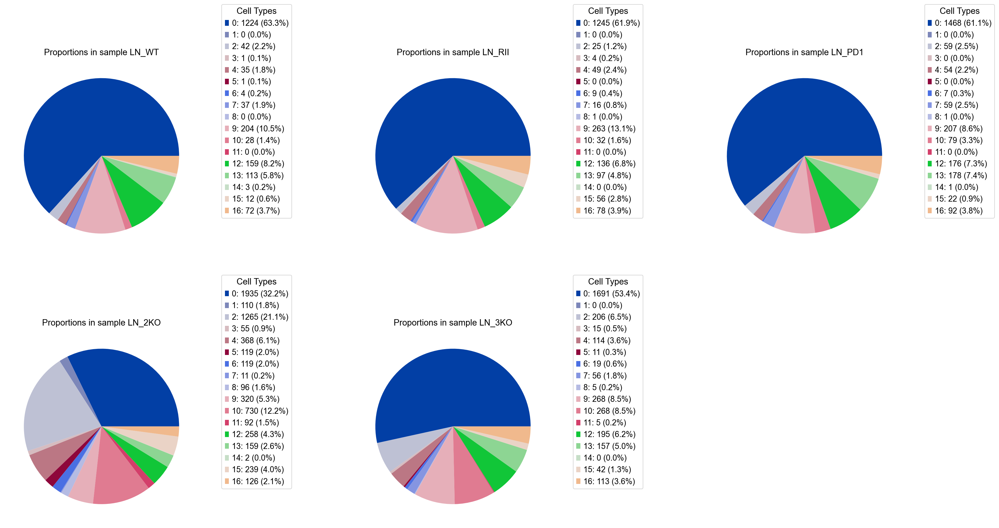

In [ ]:
unique_samples = adata.obs['sample'].unique()
nrows = 4
ncols = 3
fig, axs = plt.subplots(nrows, ncols, figsize = (8*ncols, 6*nrows))
axs = axs.flatten()  # Flatten to easily iterate over

# Assuming adata.obs['samples'] contains sample IDs and adata.obs['cluster'] contains cluster labels
grouped = adata.obs.groupby(['sample', 'pheno_louvain']).size().reset_index(name='counts')

for i, sample_val in enumerate(unique_samples):
    sample_data = grouped[grouped['sample'] == sample_val]
    if 'LN' in sample_val:
        # Cut or extend the color palette to the needed number of colors
        colors = sc.pl.palettes.zeileis_28
        colors_needed = len(sample_data)
        if colors_needed > len(colors):
            print(f"Warning: Not enough colors in palette, consider using another palette.")
        else:
            colors = colors[:colors_needed]

        # Create the pie chart in the correct subplot
        wedges, texts= axs[i].pie(
            sample_data['counts'], 
            labels=None,  # No labels inside pie chart
            autopct=None,  # No autopct inside pie chart
            colors=colors
        )

        # Prepare labels with counts and percentages for the legend
        labels_with_counts_and_percentages = [
            f"{row['pheno_louvain']}: {row['counts']} ({row['counts']/sample_data['counts'].sum()*100:.1f}%)"
            for _, row in sample_data.iterrows()
        ]

        # Add a legend with the labels, counts, and percentages
        axs[i].legend(wedges, labels_with_counts_and_percentages,
                title="Cell Types",
                loc="upper right",
                bbox_to_anchor=(1, 0.3, 0.5, 1))
        
        axs[i].set_title(f'Proportions in sample {sample_val}')

# Remove unused subplots
if len(axs) > 5:
    for i in range(5, len(axs)):
        fig.delaxes(axs[i])
plt.subplots_adjust(hspace=0.5)  # Increase the space between subplots
plt.tight_layout()
plt.show()

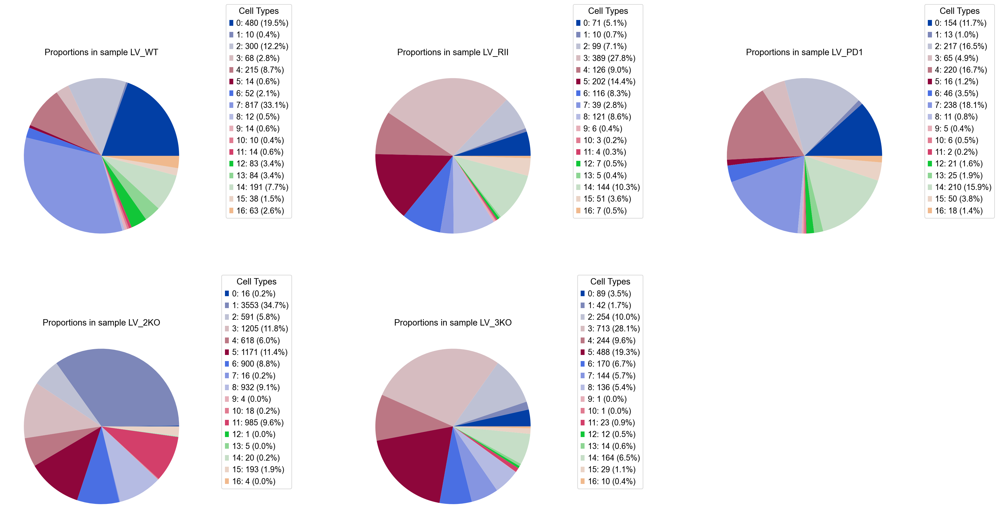

In [ ]:
unique_samples = adata.obs['sample'].unique()
nrows = 4
ncols = 3
fig, axs = plt.subplots(nrows, ncols, figsize = (8*ncols, 6*nrows))
axs = axs.flatten()  # Flatten to easily iterate over

# Assuming adata.obs['samples'] contains sample IDs and adata.obs['cluster'] contains cluster labels
grouped = adata.obs.groupby(['sample', 'pheno_louvain']).size().reset_index(name='counts')

for i, sample_val in enumerate(unique_samples):
    sample_data = grouped[grouped['sample'] == sample_val]
    if 'LV' in sample_val:
        # Cut or extend the color palette to the needed number of colors
        colors = sc.pl.palettes.zeileis_28
        colors_needed = len(sample_data)
        if colors_needed > len(colors):
            print(f"Warning: Not enough colors in palette, consider using another palette.")
        else:
            colors = colors[:colors_needed]

        # Create the pie chart in the correct subplot
        wedges, texts= axs[i-5].pie(
            sample_data['counts'], 
            labels=None,  # No labels inside pie chart
            autopct=None,  # No autopct inside pie chart
            colors=colors
        )

        # Prepare labels with counts and percentages for the legend
        labels_with_counts_and_percentages = [
            f"{row['pheno_louvain']}: {row['counts']} ({row['counts']/sample_data['counts'].sum()*100:.1f}%)"
            for _, row in sample_data.iterrows()
        ]

        # Add a legend with the labels, counts, and percentages
        axs[i-5].legend(wedges, labels_with_counts_and_percentages,
                title="Cell Types",
                loc="upper right",
                bbox_to_anchor=(1, 0.3, 0.5, 1))
        
        axs[i-5].set_title(f'Proportions in sample {sample_val}')

# Remove unused subplots
if len(axs) > 5:
    for i in range(5, len(axs)):
        fig.delaxes(axs[i])
plt.subplots_adjust(hspace=0.5)  # Increase the space between subplots
plt.tight_layout()
plt.show()

#### UMAP by hash

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_util

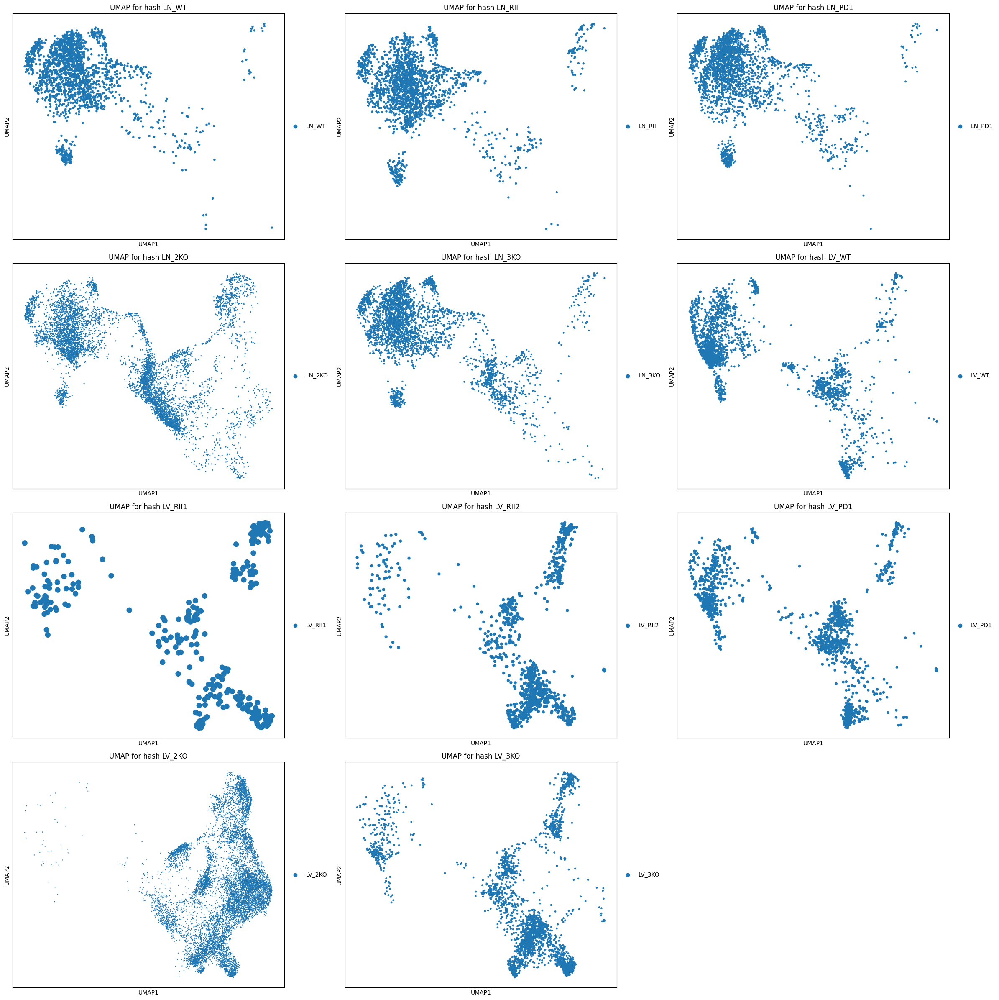

In [ ]:
unique_hashes = adata.obs['hash'].unique()
nrows = 4
ncols = 3
fig, axs = plt.subplots(nrows, ncols, figsize = (8*ncols, 6*nrows))
axs = axs.flatten()  # Flatten to easily iterate over

for i, hash_val in enumerate(unique_hashes):
    adata_subset = adata[adata.obs['hash'] == hash_val]
    # Plot in the correct subplot
    sc.pl.umap(adata_subset, color='hash', title=f'UMAP for hash {hash_val}', ax=axs[i], show=False)

# Remove unused subplots
if len(axs) > len(unique_hashes):
    for i in range(len(unique_hashes), len(axs)):
        fig.delaxes(axs[i])

plt.tight_layout()
plt.show()

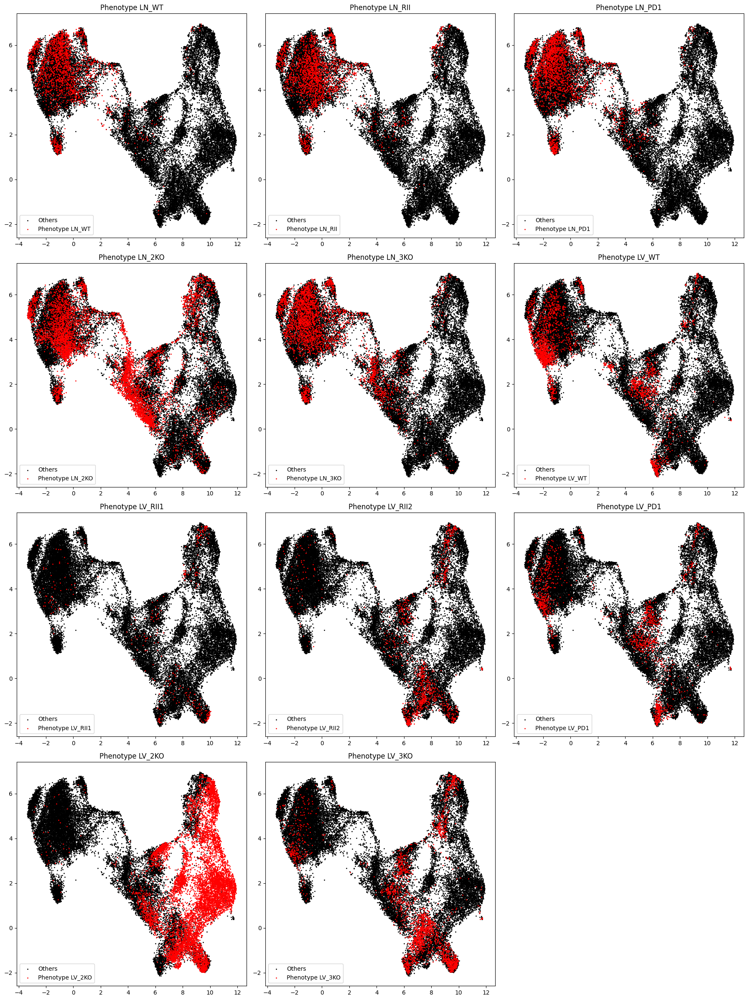

In [ ]:
# Define the number of unique phenotypes
unique_phenotypes = adata.obs['hash'].unique()
n_phenotypes = len(unique_phenotypes)
nrows = 4
ncols = 3
fig, axs = plt.subplots(nrows, ncols, figsize = (6*ncols, 6*nrows))  # Adjust this according to your needs
axs = axs.ravel()  # Flatten the axes for easy indexing

for i in range(n_phenotypes):  
    phenotype_val = unique_phenotypes[i]
    
    cells = (adata.obs['hash'] == phenotype_val)
    
    axs[i].scatter(adata.obsm['X_umap'][~cells, 0], adata.obsm['X_umap'][~cells, 1], s=1, c='k', label='Others')
    axs[i].scatter(adata.obsm['X_umap'][cells, 0], adata.obsm['X_umap'][cells, 1], s=1, c='r', label=f'Phenotype {phenotype_val}')
    axs[i].set_title(f'Phenotype {phenotype_val}')
    axs[i].legend()
    axs[i].grid(False)

# Hide any additional subplots (if any)
if len(axs) > n_phenotypes:
    for j in range(n_phenotypes, len(axs)):
        axs[j].axis('off')

plt.tight_layout()
plt.show()

#### rank_genes_groups

In [ ]:
sc.tl.rank_genes_groups(adata, 'pheno_louvain_1.0', method='wilcoxon', key_added = "wilcoxon")

In [ ]:
sc.tl.rank_genes_groups(adata, 'pheno_louvain_1.4', method='wilcoxon', key_added = "wilcoxon_1.4")

In [ ]:
sc.tl.rank_genes_groups(adata, 'annotation_1.4', method='wilcoxon', key_added = "wilcoxon_annotation_1.4")

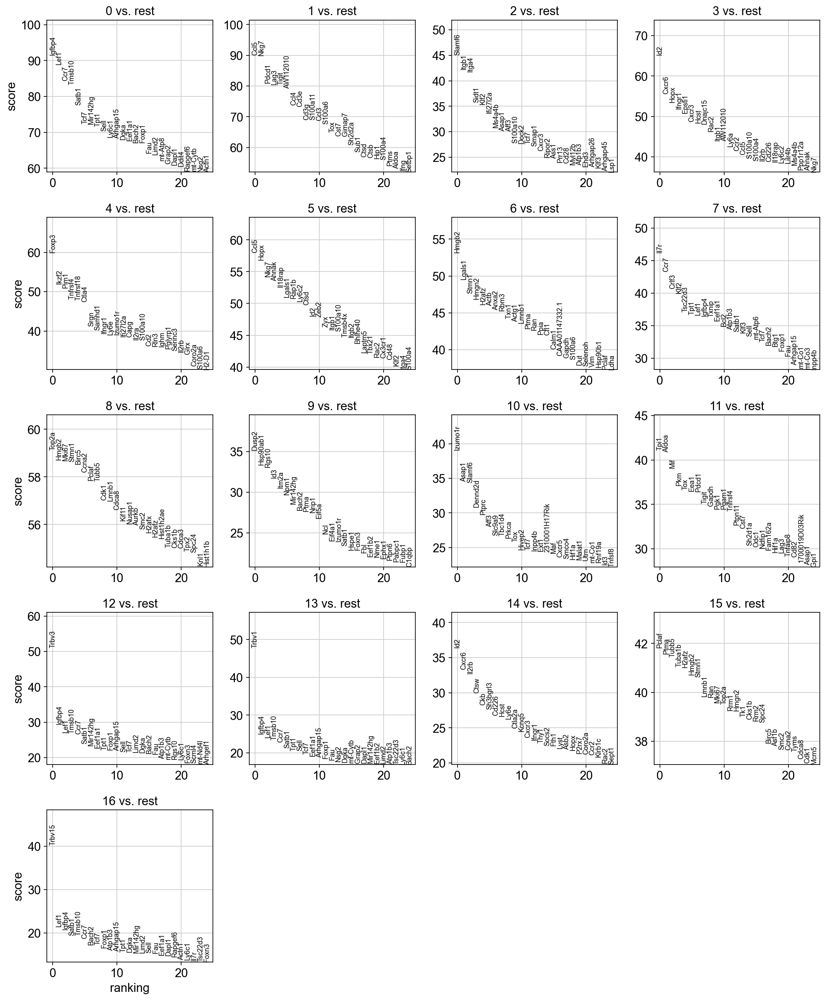

In [ ]:
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False, key="wilcoxon_1.4")

In [ ]:
adata_LN = adata[adata.obs["organ"] == 'LN']
adata_LV = adata[adata.obs["organ"] == 'LV']

In [ ]:
sc.tl.rank_genes_groups(adata_LN, 'annotation_1.4', method='wilcoxon', key_added = "wilcoxon_annotation_LN1.4")


/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:580: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}


In [ ]:
sc.tl.rank_genes_groups(adata_LV, 'annotation_1.4', method='wilcoxon', key_added = "wilcoxon_annotation_LV1.4")

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:580: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}


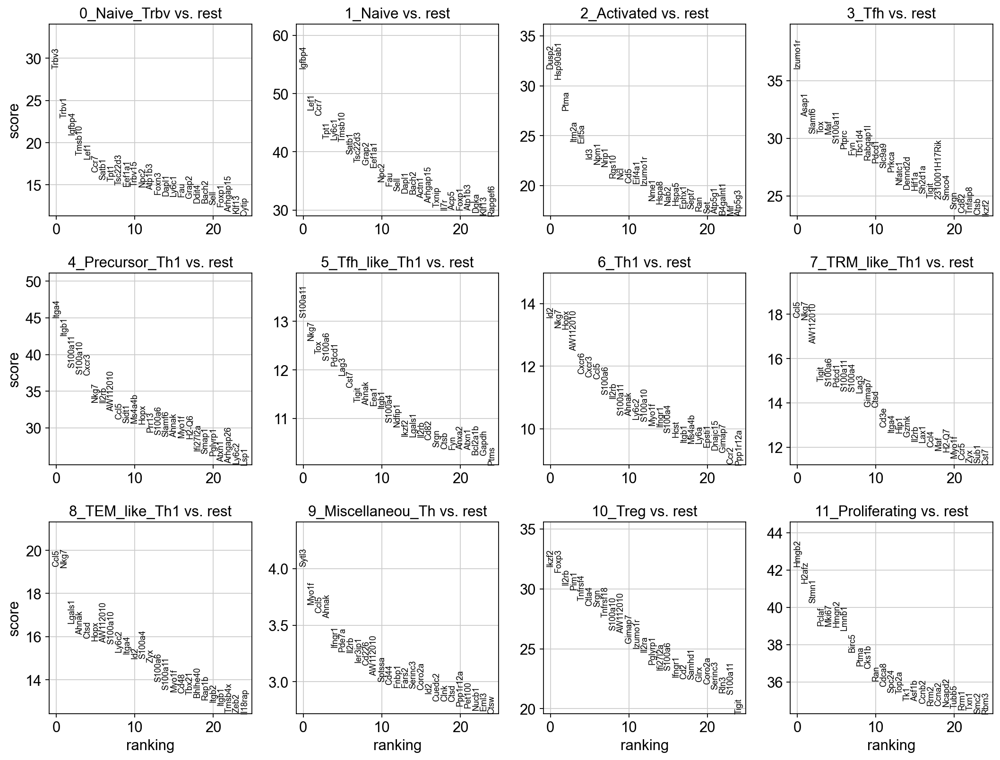

In [ ]:
sc.pl.rank_genes_groups(adata_LN, n_genes=25, sharey=False, key="wilcoxon_annotation_LN1.4")

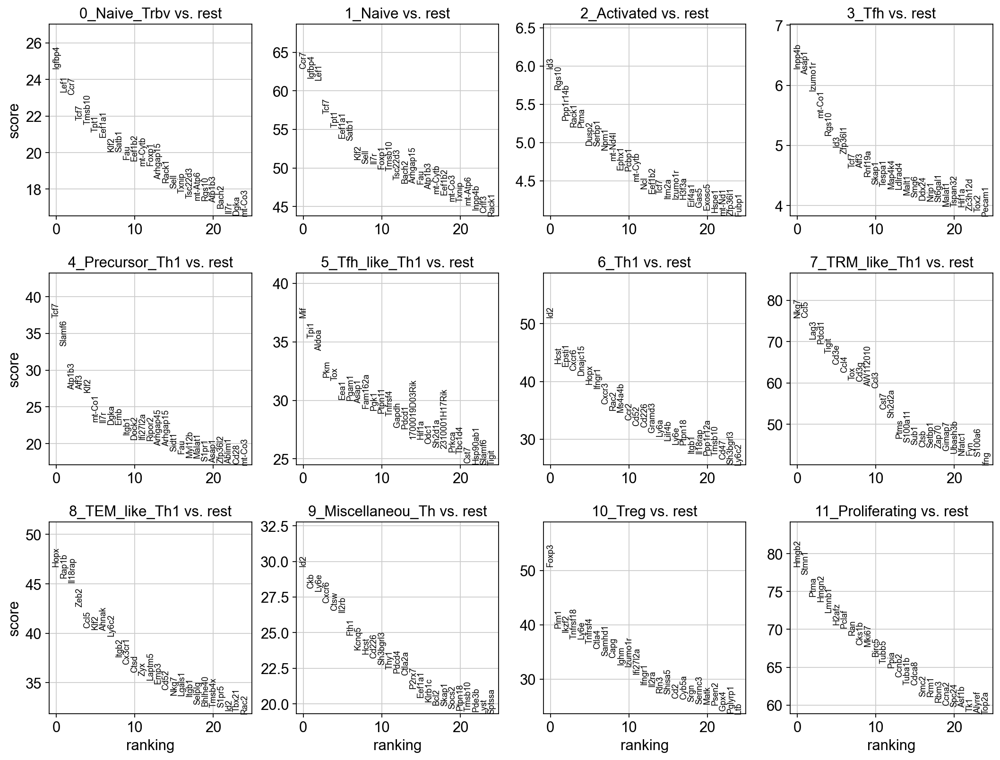

In [ ]:
sc.pl.rank_genes_groups(adata_LV, n_genes=25, sharey=False, key="wilcoxon_annotation_LV1.4")

categories: 0, 1, 2, etc.
var_group_labels: CD4_T, Tfh, Treg, etc.


/Users/gaos1/anaconda3/envs/py39/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


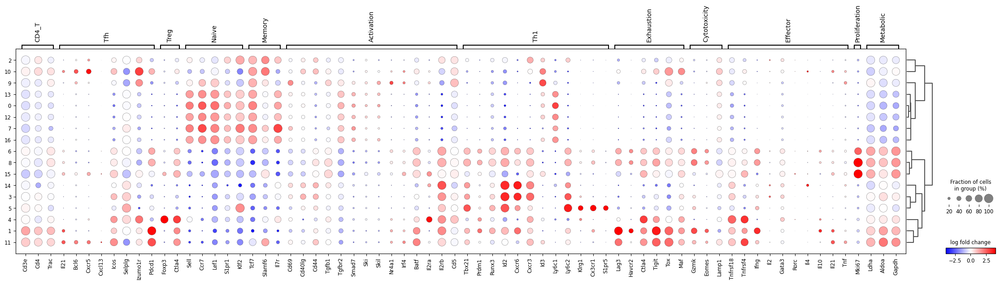

In [ ]:
var_names = {'CD4_T': ['Cd3e', 'Cd4', 'Trac'],
                'Tfh':['Il21', 'Bcl6', 'Cxcr5', 'Cxcl13', 'Icos', 'Selplg', 'Izumo1r', 'Pdcd1'],
                'Treg':['Foxp3', 'Ctla4'],
                'Naive': ['Sell', 'Ccr7', 'Lef1', 'S1pr1', 'Klf2'],
                'Memory':['Tcf7', 'Slamf6', 'Il7r'],
                'Activation': ['Cd69', 'Cd40lg', 'Cd44', 'Tgfb1', 'Tgfbr2','Smad7', 'Ski','Skil', 'Nr4a1', 'Irf4', 'Batf', 'Il2ra', 'Il2rb', 'Cd5'],
                'Th1': ['Tbx21', 'Prdm1', 'Runx3', 'Id2', 'Cxcr6', 'Cxcr3', 'Id3', 'Ly6c1', 'Ly6c2', 'Klrg1', 'Cx3cr1', 'S1pr5'],
                'Exhaustion':['Lag3','Havcr2','Ctla4', 'Tigit', 'Tox', 'Maf'],
                'Cytotoxicity': ['Gzmk', 'Eomes', 'Lamp1'],
                'Effector':['Tnfrsf18', 'Tnfrsf4', 'Ifng', 'Il2', 'Gata3', 'Rorc', 'Il4', 'Il10', 'Il21', 'Tnf'],
                'Proliferation': ['Mki67'],
                'Metabolic': ['Ldha', 'Aldoa', 'Gapdh']
               }
fig = sc.pl.rank_genes_groups_dotplot(
    adata,
    var_names=var_names,
    values_to_plot="logfoldchanges",
    cmap='bwr',
    vmin=-4,
    vmax=4,
    min_logfoldchange=3,
    colorbar_title='log fold change',
    key="wilcoxon_1.4"
)

#### heatmap

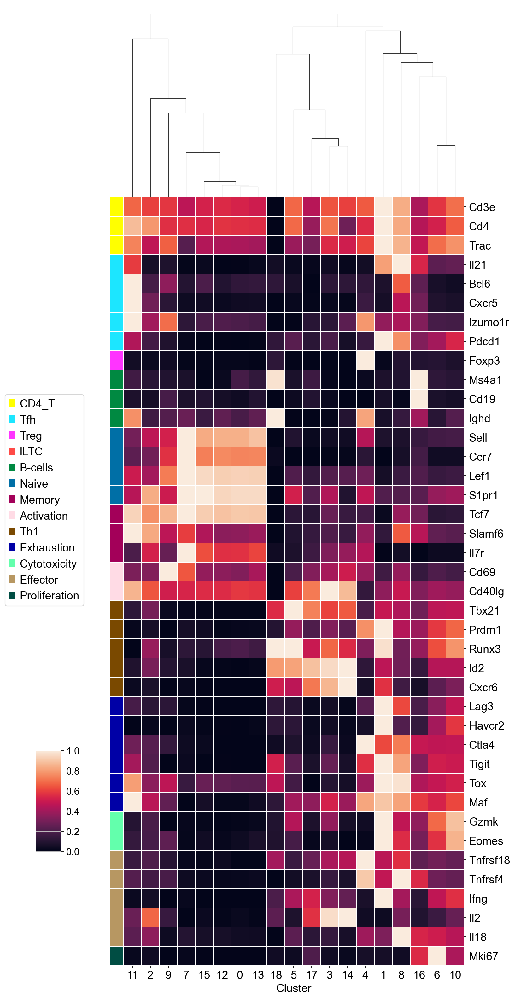

In [ ]:
markers_dict = {'CD4_T': ['Cd3e', 'Cd4', 'Trac'],
                'Tfh':['Il21', 'Bcl6', 'Cxcr5', 'Izumo1r', 'Pdcd1'],
                'Treg':['Foxp3'],
                'ILTC': ['Fcer1r'],
                'B-cells': ['Ms4a1', 'Cd19', 'Ighd'],
                'Naive': ['Sell', 'Ccr7', 'Lef1', 'S1pr1'],
                'Memory':['Tcf7', 'Slamf6', 'Il7r'],
                'Activation': ['Cd69', 'Cd40lg'],
                'Th1': ['Tbx21', 'Prdm1', 'Runx3', 'Id2', 'Cxcr6', 'Ly6c2' 'Ifngr'],
                'Exhaustion':['Lag3','Havcr2','Ctla4', 'Cd244', 'Tigit', 'Tox', 'Maf'],
                'Cytotoxicity': ['GzmB', 'Gzmk', 'Eomes'],
                'Effector':['Tnfrsf18', 'Tnfrsf4', 'Ifng', 'Il2', 'Il18'],
                'Proliferation': ['Mki67']
               }

ALLMARKERS = []
for key, value in markers_dict.items():
    markers_dict[key] = [j for j in value if j in adata.var_names]
    ALLMARKERS = ALLMARKERS + [j for j in markers_dict[key]]

# get some color palette
cols = sc.pl.palettes.godsnot_102
celltype_col = []
ct = 0
for key, value in markers_dict.items():
    celltype_col = celltype_col + [cols[ct]]*len(value)
    ct = ct + 1

sub_data = adata.X[:, [adata.var_names.get_loc(j) for j in ALLMARKERS]]
sub_data = pd.DataFrame(sub_data, columns = ALLMARKERS, index = adata.obs_names)
sub_data['Cluster'] = adata.obs['pheno_louvain_1.0']

sub_data_avg = sub_data.groupby('Cluster').mean()

g = sns.clustermap(sub_data_avg.T, standard_scale = 0,row_cluster = False, col_cluster = True,
                   figsize = (10, 20), linewidths = 0.005, cbar_pos=(0.05, .15, .05, .1), row_colors = celltype_col)
g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_ymajorticklabels(), fontsize = 16)
g.ax_heatmap.set_xticklabels(g.ax_heatmap.get_xmajorticklabels(), fontsize = 16)
g.ax_heatmap.set_xlabel('Cluster', fontsize = 16)
g.ax_heatmap.grid(False)  # Turn off the grid

# Draw the legend bar for the classes                 
for ct, label in enumerate([j for j in markers_dict.keys()]):
    g.ax_col_dendrogram.bar(0, 0, color=cols[ct], label=label, linewidth=0)
g.ax_col_dendrogram.legend(ncol=1, bbox_to_anchor = (-0.1, -1), fontsize = 16, markerscale = 3)

# To save
#g.savefig('/path/to/save/heatmap_annot.png', dpi = 100, bbox_inches = 'tight')

### Annotation

In [ ]:
# dictionary mapping Leiden cluster labels to annotations
# 0/7 (naive) (partly CD40 dependent) -> 9 (early activation) (TGFb blockes, partly CD40-dependent) ->

# 9-> 2 (Th_effector_precursor) -> go to tissue
# 9 -> 10 (Tfh_effector)

# tissue
# 2 -> 11 (Tfh_like_effector) (blocked by PD1?)
# 2 -> 3  (early_Th1)

# 3 -> 5 (Circulating_Th1) # S1pr5, Klrg1, Cx3cr1
# 3 -> 1 (Hyperactivated_Th1) # no CD69

# 14 (Memory_like_Th)

cluster_annotation_mapping_14 = {
    '0': '01_Naive', ###
    '1': '07_TRM_like_Th1', #
    '2': '04_Precursor_Th1', #central memo type of cell, Tfh like (both tissue, LN, high S1pr1)
    '3': '06_Th1', ## early
    '4': '10_Treg', #
    '5': '08_TEM_like_Th1', ## more activated
    '6': '11_Proliferating', #old 10
    '7': '01_Naive', ### slight activation, tissue
    '8': '11_Proliferating', # old 6
    '9': '02_Activated', #
    '10': '03_Tfh', # GC
    '11': '05_Tfh_like_Th1', ## CXCL13, metabolic active
    '12': '00_Naive_Trbv', ### Trbv3
    '13': '00_Naive_Trbv', ### slight activation Trbv1
    '14': '09_Miscellaneous_Th', ## early
    '15': '11_Proliferating', 
    '16': '00_Naive_Trbv', #Trbv15
}

# Map the Leiden cluster labels to the annotations using the dictionary
adata.obs['annotation_1.4'] = adata.obs['pheno_louvain_1.4'].map(cluster_annotation_mapping_14)

In [ ]:
adata.obs['annotation'] = adata.obs['annotation_1.4']

In [ ]:
print(adata.obs['annotation_1.4'].unique())

['01_Naive' '02_Activated' '00_Naive_Trbv' '04_Precursor_Th1'
 '11_Proliferating' '03_Tfh' '10_Treg' '08_TEM_like_Th1'
 '09_Miscellaneous_Th' '06_Th1' '07_TRM_like_Th1' '05_Tfh_like_Th1']


In [ ]:
categories_order = sorted(adata.obs['annotation'].unique())
categories_order

['00_Naive_Trbv',
 '01_Naive',
 '02_Activated',
 '03_Tfh',
 '04_Precursor_Th1',
 '05_Tfh_like_Th1',
 '06_Th1',
 '07_TRM_like_Th1',
 '08_TEM_like_Th1',
 '09_Miscellaneous_Th',
 '10_Treg',
 '11_Proliferating']

In [ ]:
# Extract unique categories for 'annotation_1.4' and ensure consistent order
categories_order = sorted(adata.obs['annotation'].unique())

# Define a color palette for them (ensure it has enough colors)
colors = plt.cm.tab20(np.linspace(0, 1, len(categories_order)))
colors_tab20 = plt.cm.tab20(np.linspace(0, 1, len(categories_order)))
palette_dict = dict(zip(categories_order, colors))

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


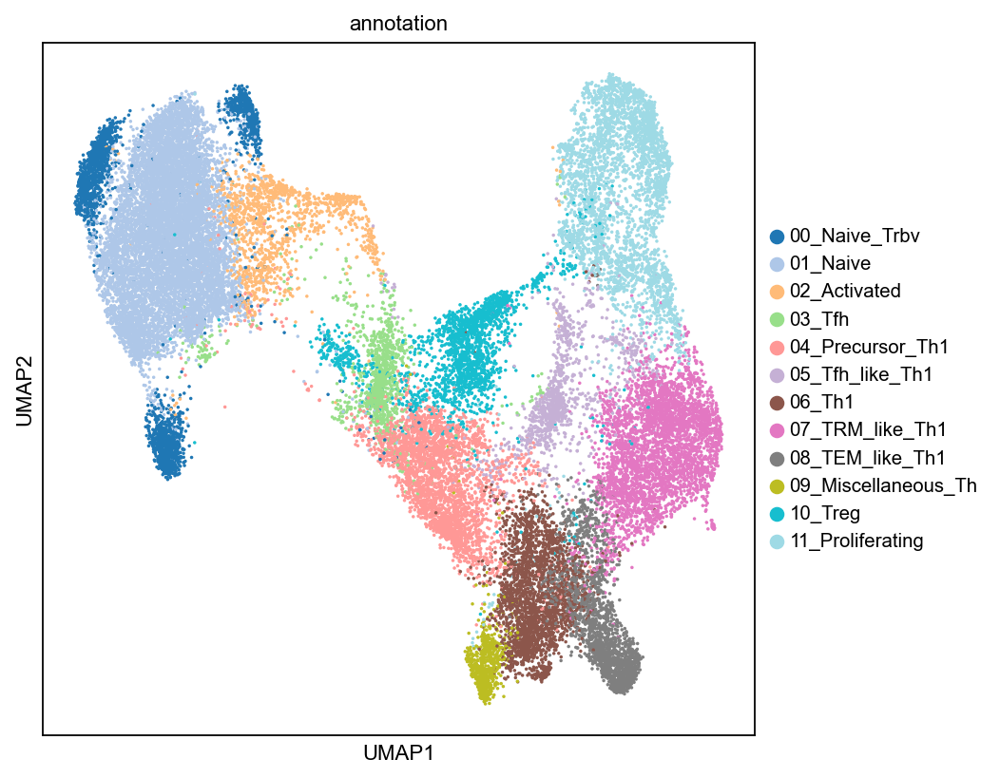

In [ ]:
#sc.set_figure_params(scanpy=True, fontsize = 10, figsize = (6, 6))
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=300, frameon=True, vector_friendly=True, 
                     fontsize=10, figsize=[6,6], color_map=None, format='pdf', 
                     facecolor=None, transparent=False, ipython_format='png2x')
sc.pl.umap(adata, color = 'annotation', s = 10, palette = palette_dict, ncols = 1, save = '2a_1_UMAP.pdf')
# Get the current figure and save it
#fig = plt.gcf()
#fig.savefig('grant_figure/2a_1_UMAP.pdf', format='pdf', dpi=300)

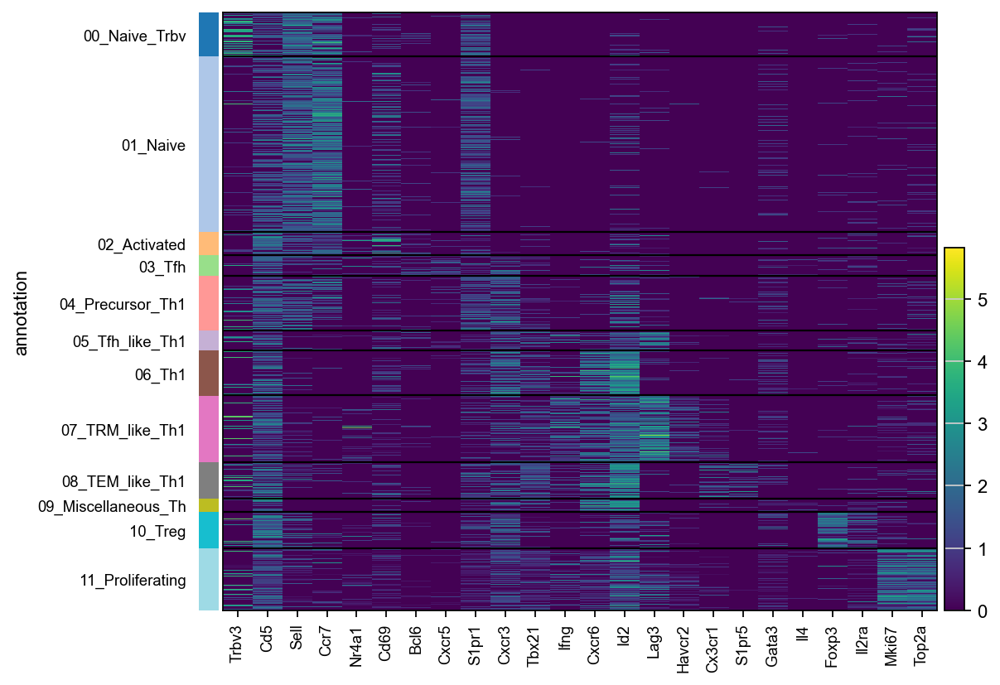

In [ ]:
# Set the global font size
plt.rcParams.update({'font.size':10})
markers = ['Trbv3', 'Cd5', 
           'Tcf7', 'Ccr7', 
           'Nr4a1', 'Cd69',
           'Bcl6', 'Cxcr5',
           'S1pr1', 'Cxcr3',
           'Tbx21', 'Ifng',
           'Id2', 'Cxcr6',
           'Tox', 'Ctla4',
           'S1pr5','Cx3cr1',
           'Gata3', 'Il4',
           'Foxp3', 'Il2ra',
           'Mki67', 'Top2a']
sc.pl.heatmap(adata, markers, groupby='annotation', save = '2a_2_heatmap.pdf')

In [ ]:
plt.rcParams.update({'font.size': 10})

In [ ]:
markers = ['Trbv3', 'Cd5', 
           'Tcf7', 'Ccr7', 
           'Nr4a1', 'Cd69',
           'Bcl6', 'Cxcr5',
           'S1pr1', 'Cxcr3',
           'Tbx21', 'Ifng',
           'Id2', 'Cxcr6',
           'Tox', 'Ctla4',
           'S1pr5','Cx3cr1',
           'Gata3', 'Il4',
           'Foxp3', 'Il2ra',
           'Mki67', 'Top2a']

/Users/gaos1/anaconda3/envs/py39/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


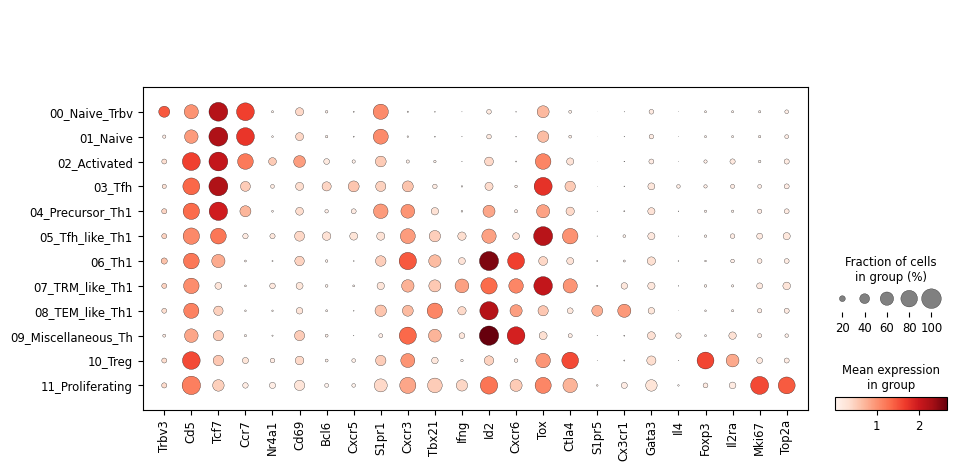

In [ ]:
sc.pl.dotplot(adata, markers, groupby='annotation', save = 'dotplot_new.pdf')

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


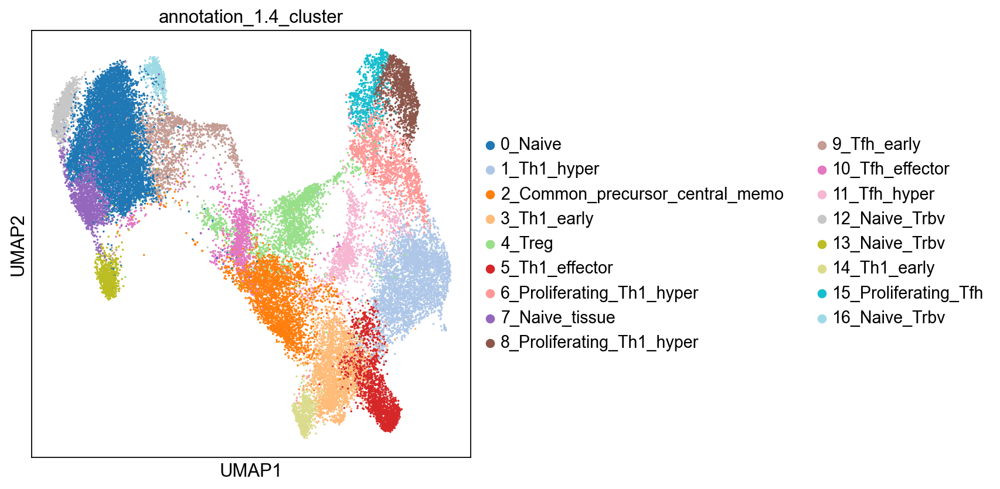

In [ ]:
sc.set_figure_params(scanpy=True, fontsize = 14, figsize = (6, 6))
sc.pl.umap(adata, color = 'annotation_1.4_cluster', s = 10, palette = 'tab20', ncols = 1)

In [ ]:
adata

AnnData object with n_obs × n_vars = 33466 × 16096
    obs: 'hash', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mito_frac', 'ribo_frac', 'doublet_score', 'predicted_doublet', 'predicted_doublet_as_string', 'pheno_louvain_0.4', 'pheno_louvain_0.6', 'pheno_louvain_1.0', 'annotation_v1', 'organ', 'sample', 'genotype', 'pheno_louvain_1.4', 'pheno_louvain_1.0#', 'pheno_louvain_0.4#', 'pheno_louvain_0.6#', 'pheno_louvain_1.4#', 'pheno_louvain', 'annotation_1.4', 'annotation_1.4_cluster'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'annotation_1.4_colors', 'color_colors', 'dendrogram_pheno_louvain', 'dendrogram_pheno_louvain_1.4', 'draw_graph', 'h

##### save

In [ ]:
adata.write_h5ad('intermediate/half_dead_cells_removed_pheno_louvain_annotation14_grant.h5ad')
# adata = sc.read_h5ad('intermediate/half_dead_cells_removed_pheno_louvain_annotation14_grant.h5ad')

In [ ]:
adata_LV.write_h5ad('intermediate/annotation14_grant_adata_LV.h5ad')
# adata_LV = sc.read_h5ad('intermediate/annotation14_grant_adata_LV.h5ad')

In [ ]:
adata_LN.write_h5ad('intermediate/annotation14_grant_adata_LN.h5ad')
# adata_LN = sc.read_h5ad('intermediate/annotation14_grant_adata_LN.h5ad')

## END